In [20]:
using Plots, ColorSchemes, Statistics
Plots.default(fontfamily="Computer Modern")

include("src/PolyColloid.jl")
using .PolyColloid

using CUDA
CUDA.allowscalar(true)

In [22]:
function plotsim(sim, filepath)
    colors = [get(ColorSchemes.vikO, mod(angle, π/2) / (π/2))
              for angle in Array(sim.colloid.angles)]
    p1 = plot(sim.colloid, colors, title="Orientation")

    colors = [get(ColorSchemes.vik, order)
              for order in Array(abs.(sim.recorders[1].values[end]))]
    p2 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=4\$")

    colors = [get(ColorSchemes.vik, order)
              for order in Array(abs.(sim.recorders[2].values[end]))]
    p3 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=6\$")

    colors = [get(ColorSchemes.vik, order)
              for order in Array(abs.(sim.recorders[3].values[end]))]
    p4 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=8\$")

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    savefig(p, filepath)
    display(p)
end

function plotorders(sim, filepath)
    p1 = plot(sim.recorders[end].times, abs.(sim.recorders[end].values),
              ylabel="Mean Orientation")
    p2 = plot(sim.recorders[1].times, mean.([abs.(order)
              for order in sim.recorders[1].values]),
              ylabel="Mean \$k\$-atic Order, \$k=4\$")
    p3 = plot(sim.recorders[2].times, mean.([abs.(order)
              for order in sim.recorders[2].values]),
              ylabel="Mean \$k\$-atic Order, \$k=6\$")
    p4 = plot(sim.recorders[3].times, mean.([abs.(order)
              for order in sim.recorders[3].values]),
              ylabel="Mean \$k\$-atic Order, \$k=8\$")
    p = plot!(p1, p2, p3, p4, layout=(2, 2), legend=false,
              xlabel="t", color=:mediumblue, size=(800, 600))
    savefig(p, filepath)
    display(p)
end

plotorders (generic function with 1 method)

In [23]:
n = 1024

1024

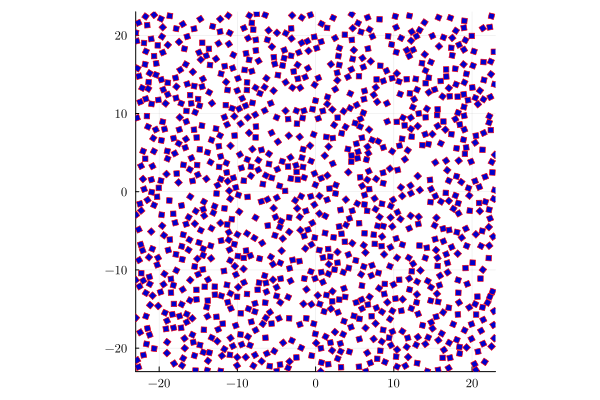

In [24]:
sim = PolyColloid.Simulation(n, 4, 0.5, (ceil(Int, √(2n)), ceil(Int, √(2n))), gpu=true)
PolyColloid.crystallize!(sim.colloid)
sim.move_radius = 0.25
sim.rotation_span = π / 8
PolyColloid.run!(sim, 5n)
plot(sim.colloid)

In [25]:
p_area = PolyColloid.particle_area(sim.colloid)
initial_area_fraction = PolyColloid.particle_count(sim.colloid) * p_area / PolyColloid.boxarea(sim.colloid)

0.24196597353497165

In [26]:
final_area_fraction = 0.8
target_sidelen = Float32(√(PolyColloid.particle_count(sim.colloid) * p_area / final_area_fraction))

25.298222f0

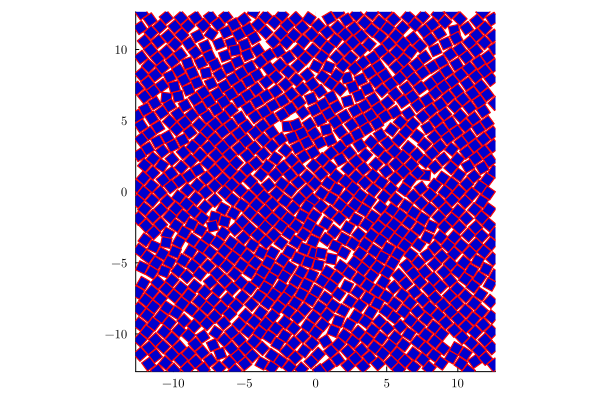

In [27]:
push!(sim.updaters, PolyColloid.MoveSizeTuner(
    t -> t % 50 == 0, 0.2; max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, PolyColloid.ForcefulCompressor(
    t -> t % 100 == 0, (target_sidelen, target_sidelen)))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 4))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 6))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 8))
push!(sim.recorders, PolyColloid.GlobalParamRecorder(
    t -> t % 100 == 0, "orient"))
PolyColloid.run!(sim, 100n)
plot(sim.colloid, ratio=:equal)

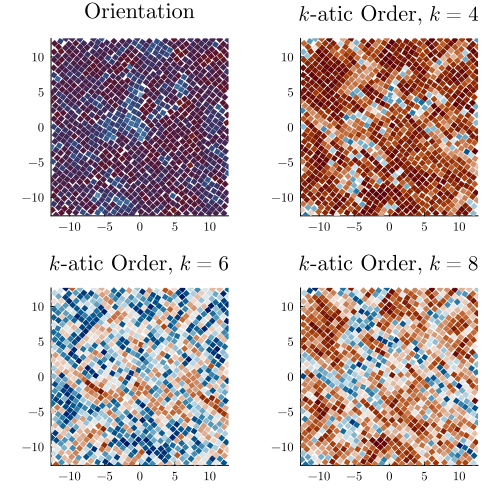

In [32]:
plotsim(sim, "../fig/katic_compress.pdf")

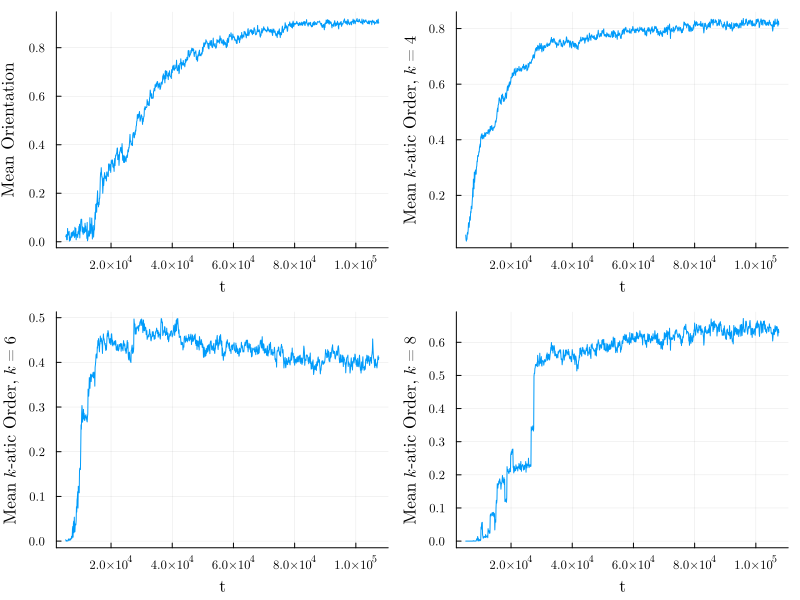

In [33]:
plotorders(sim, "../fig/katic_compress_time.pdf")

In [34]:
empty!(sim.updaters)
empty!(sim.updaters)

Main.PolyColloid.AbstractUpdater[]

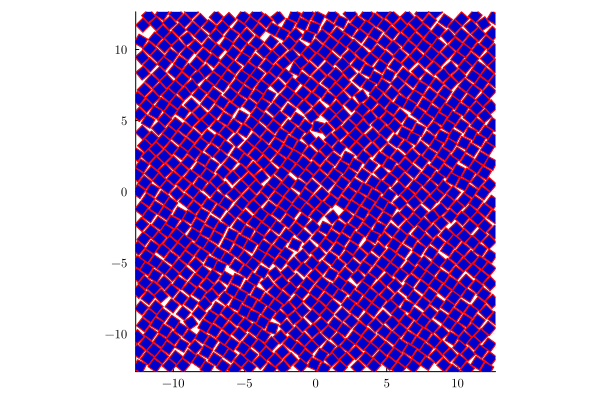

In [35]:
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 4))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 6))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 8))
push!(sim.recorders, PolyColloid.GlobalParamRecorder(
    t -> t % 100 == 0, "orient"))
PolyColloid.run!(sim, 100n)
p = plot(sim.colloid, ratio=:equal)

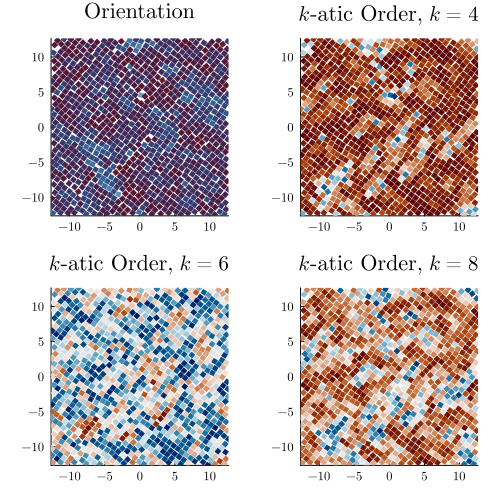

In [36]:
plotsim(sim, "../fig/katic_equilibrium.pdf")

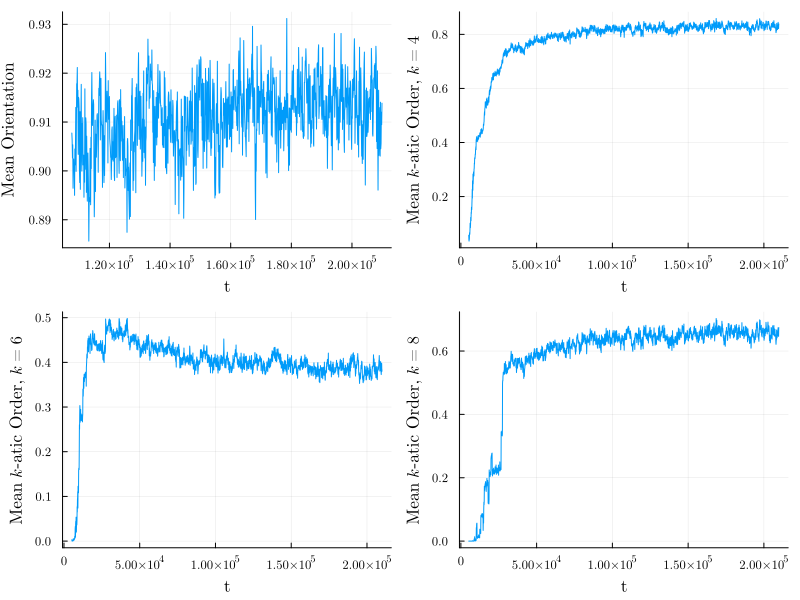

In [37]:
plotorders(sim, "../fig/katic_equilibrium_time.pdf")

In [3]:
function plotsimdisk(sim, r, filepath)
    colors = [get(ColorSchemes.vikO, mod(angle, π/2) / (π/2))
            for angle in Array(sim.colloid.angles)]
    p1 = plot(sim.colloid, colors, title="Orientation")
    plot!(p1, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = [get(ColorSchemes.vik, order)
            for order in Array(abs.(mean.(sim.recorders[1].values[end])))]
    p2 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=4\$")
    plot!(p2, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = [get(ColorSchemes.vik, order)
            for order in Array(abs.(mean.(sim.recorders[2].values[end])))]
    p3 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=6\$")
    plot!(p3, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    colors = [get(ColorSchemes.vik, order)
            for order in Array(abs.(mean.(sim.recorders[3].values[end])))]
    p4 = plot(sim.colloid, colors, title="\$k\$-atic Order, \$k=8\$")
    plot!(p4, r * cos.(θs), r * sin.(θs), color=:black,
        alpha=0.5, seriestype=:shape)

    p = plot!(p1, p2, p3, p4, layout=(2, 2), size=(500, 500))
    savefig(p, filepath)
    display(p)
end

plotsimdisk (generic function with 1 method)

In [4]:
n = 1024

1024

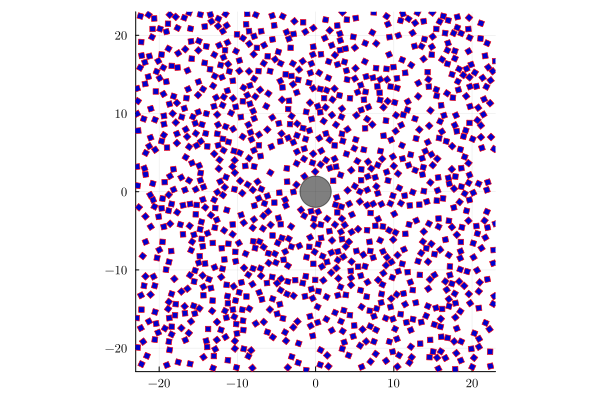

In [28]:
r = 2.0f0
sim = PolyColloid.Simulation(
      n, 4, 0.5, (ceil(√(2n)), ceil(√(2n))), gpu=true)
PolyColloid.crystallize!(sim.colloid, ceil(Int, n + π * (r + sim.colloid.radius)^2 / 2),
      (colloid, centers) -> (sum((centers .- (0.0f0, 0.0f0)).^2, dims=1)
            .> (r + colloid.radius) ^ 2))
sim.move_radius = 0.25
sim.rotation_span = π / 8
push!(sim.constraints, PolyColloid.DiskWall((0.0f0, 0.0f0), r, (x, y) -> ()))
PolyColloid.run!(sim, 5n)
p = plot(sim.colloid)
θs = collect(0:0.01:2π)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)

In [29]:
p_area = PolyColloid.particle_area(sim.colloid)
initial_area_fraction = PolyColloid.particle_count(sim.colloid) * p_area / PolyColloid.boxarea(sim.colloid)

0.24196597353497165

In [30]:
final_area_fraction = 0.8
target_sidelen = Float32(√((PolyColloid.particle_count(sim.colloid) * p_area + π * r^2) / final_area_fraction))

25.606794f0

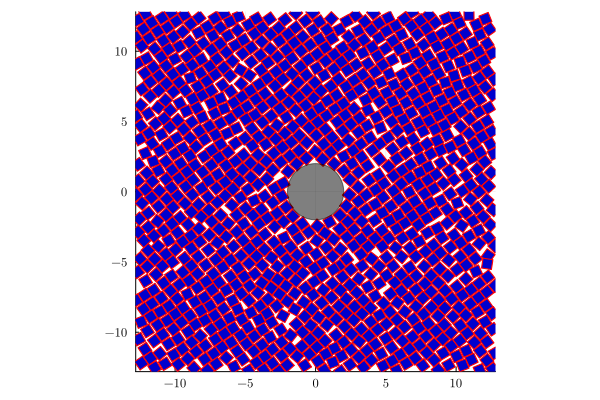

In [31]:
push!(sim.updaters, PolyColloid.MoveSizeTuner(t -> t % 50 == 0, 0.2;
      max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, PolyColloid.ForcefulCompressor(t -> t % 100 == 0, (target_sidelen, target_sidelen)))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 4))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 6))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 8))
push!(sim.recorders, PolyColloid.GlobalParamRecorder(
    t -> t % 100 == 0, "orient"))
PolyColloid.run!(sim, 100n)
p = plot(sim.colloid, ratio=:equal)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)
display(p)

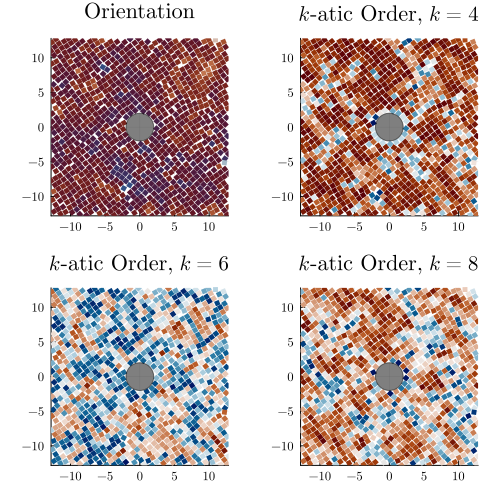

In [32]:
plotsimdisk(sim, r, "../fig/disk_katic_compress.pdf")

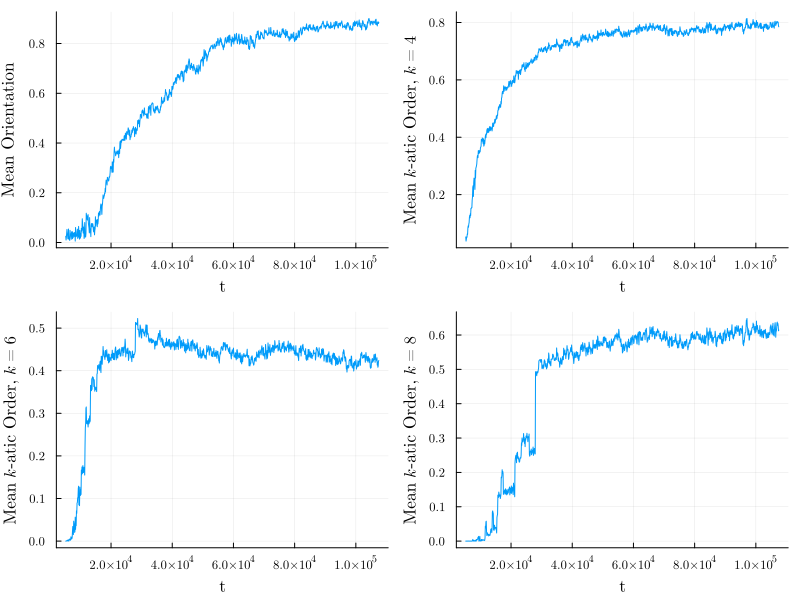

In [33]:
plotorders(sim, "../fig/disk_katic_compress_time.pdf")

In [34]:
pop!(sim.updaters)
pop!(sim.updaters)
pop!(sim.recorders)
pop!(sim.recorders)

Main.PolyColloid.LocalOrderRecorder{ComplexF32}("katic", (8,), Vector{ComplexF32}[[0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im  …  0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im], [0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im  …  0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im], [0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im  …  0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0f0 + 0.0f0im, 0.0

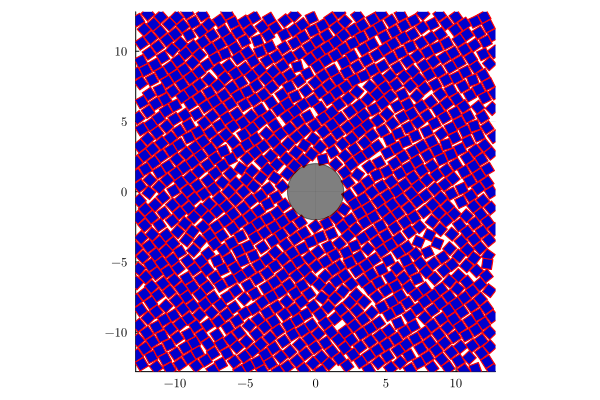

In [35]:
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 4))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 6))
push!(sim.recorders, PolyColloid.LocalParamRecorder(
    t -> t % 100 == 0, "katic", 8))
push!(sim.recorders, PolyColloid.GlobalParamRecorder(
    t -> t % 100 == 0, "orient"))
PolyColloid.run!(sim, 100n)
p = plot(sim.colloid)
plot!(p, r * cos.(θs), r * sin.(θs), color=:black,
      alpha=0.5, seriestype=:shape)
display(p)

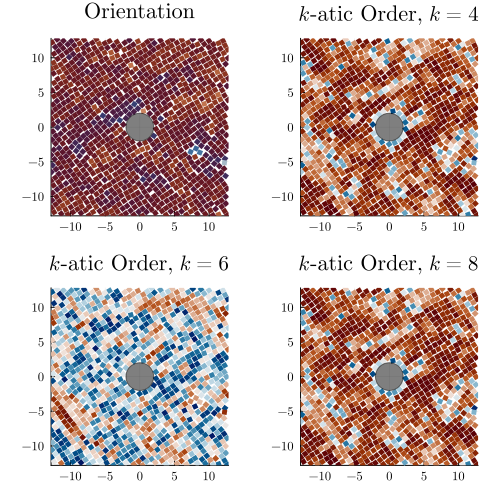

In [36]:
plotsimdisk(sim, r, "../fig/disk_katic_equilibrium.pdf")

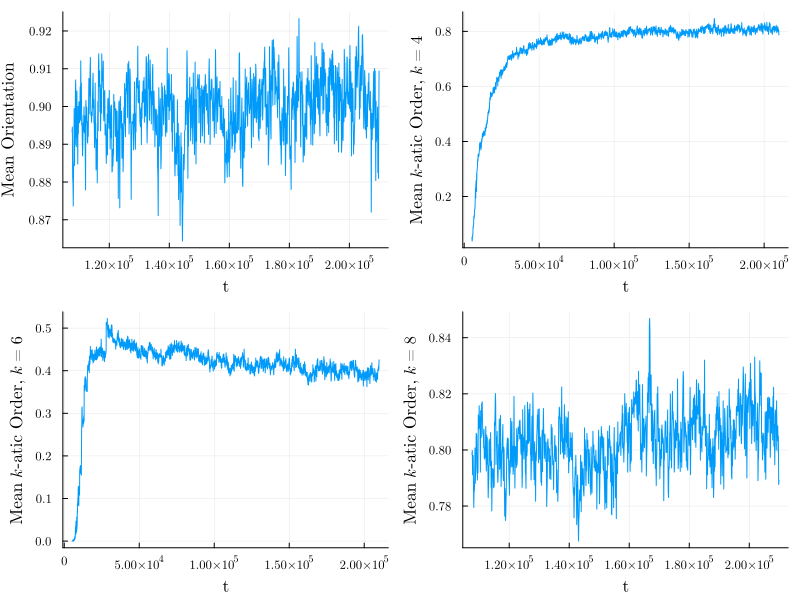

In [37]:
plotorders(sim, "../fig/disk_katic_equilibrium_time.pdf")